<a href="https://colab.research.google.com/github/xiaoyufan/speech-data-augmentation/blob/main/Copy_of_MelGAN_VC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

## Create logger

In [253]:
from importlib import reload
import logging
import sys

reload(logging)

LOGGING_LEVEL = 'DEBUG'

logger = logging.getLogger('baseline')
logger.setLevel(LOGGING_LEVEL)

formatter = logging.Formatter('[%(asctime)s - logger %(name)s - %(levelname)s] %(message)s')

ch = logging.StreamHandler(sys.stdout)
ch.setFormatter(formatter)
logger.addHandler(ch)

logger.debug('debug test')
logger.info('info test')

[2020-12-16 00:12:50,004 - logger baseline - DEBUG] debug test
[2020-12-16 00:12:50,005 - logger baseline - INFO] info test


## Install packages

In [254]:
#We'll be using TF 2.1 and torchaudio

try:
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf
!pip install soundfile                    #to save wav files
!pip install --no-deps torchaudio==0.5.0

## Mount Google Drive

In [255]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Download datasets

In [256]:
# #Dataset download (Uncomment where needed)

# #Arctic dataset for voice conversion
!wget --header="Host: festvox.org" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/76.0.3809.100 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3" --header="Accept-Language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: http://festvox.org/cmu_arctic/cmu_arctic/packed/" -nc "http://festvox.org/cmu_arctic/cmu_arctic/packed/cmu_us_bdl_arctic-0.95-release.zip" -O "cmu_us_bdl_arctic-0.95-release.zip" 
!unzip -n -qq cmu_us_bdl_arctic-0.95-release.zip #MALE1
!wget --header="Host: festvox.org" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/76.0.3809.100 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3" --header="Accept-Language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: http://festvox.org/cmu_arctic/cmu_arctic/packed/" -nc "http://festvox.org/cmu_arctic/cmu_arctic/packed/cmu_us_clb_arctic-0.95-release.zip" -O "cmu_us_clb_arctic-0.95-release.zip"
!unzip -n -qq cmu_us_clb_arctic-0.95-release.zip #FEMALE1
!wget --header="Host: festvox.org" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/76.0.3809.100 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3" --header="Accept-Language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: http://festvox.org/cmu_arctic/cmu_arctic/packed/" -nc "http://festvox.org/cmu_arctic/cmu_arctic/packed/cmu_us_rms_arctic-0.95-release.zip" -O "cmu_us_rms_arctic-0.95-release.zip" 
!unzip -n -qq cmu_us_rms_arctic-0.95-release.zip #MALE2
!wget --header="Host: festvox.org" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/76.0.3809.100 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3" --header="Accept-Language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: http://festvox.org/cmu_arctic/cmu_arctic/packed/" -nc "http://festvox.org/cmu_arctic/cmu_arctic/packed/cmu_us_slt_arctic-0.95-release.zip" -O "cmu_us_slt_arctic-0.95-release.zip"
!unzip -n -qq cmu_us_slt_arctic-0.95-release.zip #FEMALE2

# #GTZAN dataset for music genre transfer
# # !wget --header="Host: opihi.cs.uvic.ca" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/77.0.3865.90 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3" --header="Accept-Language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: http://marsyas.info/downloads/datasets.html" "http://opihi.cs.uvic.ca/sound/genres.tar.gz" -O "genres.tar.gz" -c
# # !tar -xzf genres.tar.gz

!ls

File ‘cmu_us_bdl_arctic-0.95-release.zip’ already there; not retrieving.
File ‘cmu_us_clb_arctic-0.95-release.zip’ already there; not retrieving.
File ‘cmu_us_rms_arctic-0.95-release.zip’ already there; not retrieving.
File ‘cmu_us_slt_arctic-0.95-release.zip’ already there; not retrieving.
cmu_us_bdl_arctic		    cmu_us_slt_arctic
cmu_us_bdl_arctic-0.95-release.zip  cmu_us_slt_arctic-0.95-release.zip
cmu_us_clb_arctic		    drive
cmu_us_clb_arctic-0.95-release.zip  pikle_model.pkl
cmu_us_rms_arctic		    sample_data
cmu_us_rms_arctic-0.95-release.zip


## Import packages

In [257]:
#Imports

from __future__ import print_function, division
from glob import glob
import scipy
import soundfile as sf
import matplotlib.pyplot as plt
from IPython.display import clear_output
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Concatenate, Conv2D, Conv2DTranspose, GlobalAveragePooling2D, UpSampling2D, LeakyReLU, ReLU, Add, Multiply, Lambda, Dot, BatchNormalization, Activation, ZeroPadding2D, Cropping2D, Cropping1D
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.initializers import TruncatedNormal, he_normal
import tensorflow.keras.backend as K
import datetime
import numpy as np
import random
import matplotlib.pyplot as plt
import collections
from PIL import Image
from skimage.transform import resize
import imageio
import librosa
import librosa.display
from librosa.feature import melspectrogram
import os
import time
import IPython

## Configurations

#### Get notebook's start time

In [258]:
from datetime import datetime, tzinfo
import pytz

NB_RUN_TIME = datetime.now(tz=pytz.timezone('US/Eastern')).strftime('%Y%m%d-%H%M%S')
logger.info(f'Notebook started at {NB_RUN_TIME}.')

[2020-12-16 00:12:55,560 - logger baseline - INFO] Notebook started at 20201215-191255.


### Hyperparameters

In [259]:
hop=192               #hop size (window size = 6*hop)
sr=16000              #sampling rate
min_level_db=-100     #reference values to normalize data
ref_level_db=20

shape=24              #length of time axis of split specrograms to feed to generator            
vec_len=128           #length of vector generated by siamese vector
bs = 16               #batch size
ep = 20                #epochs
delta = 2.            #constant for siamese loss

train_len=160         #number of training audios as source and target respectively

### Paths

In [260]:
PROJECT_ROOT_PATH = '/content/drive/MyDrive/nlp-project'

OUTPUT_DIR = f'{PROJECT_ROOT_PATH}/xiaoyu-melgan/{NB_RUN_TIME}'
MODELS_DIR = f'{OUTPUT_DIR}/models'
LOAD_MODEL = False
SAVED_MODEL_PATH = f'{MODELS_DIR}/'
GENERATION_SRC_DIR = f'{PROJECT_ROOT_PATH}/male_240_generation_src'
GENERATION_TGT_DIR = f'{OUTPUT_DIR}/generated/female_240'

## Create output directories

In [261]:
!mkdir -p $MODELS_DIR
!mkdir -p $GENERATION_TGT_DIR

# Training

## Define training loops

### Helper functions

In [262]:
#Helper functions

#Generate spectrograms from waveform array
def tospec(data):
  specs=np.empty(data.shape[0], dtype=object)
  for i in range(data.shape[0]):
    x = data[i]
    S=prep(x)
    S = np.array(S, dtype=np.float32)
    specs[i]=np.expand_dims(S, -1)
  print(specs.shape)
  return specs

#Generate multiple spectrograms with a determined length from single wav file
def tospeclong(path, length=4*16000):
  x, sr = librosa.load(path,sr=16000)
  x,_ = librosa.effects.trim(x)
  loudls = librosa.effects.split(x, top_db=50)
  xls = np.array([])
  for interv in loudls:
    xls = np.concatenate((xls,x[interv[0]:interv[1]]))
  x = xls
  num = x.shape[0]//length
  specs=np.empty(num, dtype=object)
  for i in range(num-1):
    a = x[i*length:(i+1)*length]
    S = prep(a)
    S = np.array(S, dtype=np.float32)
    try:
      sh = S.shape
      specs[i]=S
    except AttributeError:
      print('spectrogram failed')
  print(specs.shape)
  return specs

def load_wav_files(path, limit=None, start=0):
  wav_files = glob(f'{path}/*.wav')

  if limit:
    end = start + limit
  else:
    end = len(wav_files)

  return wav_files[start:end]

#Waveform array from path of folder containing wav files
def audio_array(path, *args, **kwargs):
  adata = []
  wav_files = load_wav_files(path, **kwargs)
  print(wav_files)

  for wav_file in wav_files:
    x, sr = tf.audio.decode_wav(tf.io.read_file(wav_file), 1)
    x = np.array(x, dtype=np.float32)
    adata.append(x)
  return np.array(adata), wav_files

#Concatenate spectrograms in array along the time axis
def testass(a):
  but=False
  con = np.array([])
  nim = a.shape[0]
  for i in range(nim):
    im = a[i]
    im = np.squeeze(im)
    if not but:
      con=im
      but=True
    else:
      con = np.concatenate((con,im), axis=1)
  return np.squeeze(con)

#Split spectrograms in chunks with equal size
def splitcut(data):
  ls = []
  mini = 0
  minifinal = 10*shape                                                              #max spectrogram length
  for i in range(data.shape[0]-1):
    if data[i].shape[1]<=data[i+1].shape[1]:
      mini = data[i].shape[1]
    else:
      mini = data[i+1].shape[1]
    if mini>=3*shape and mini<minifinal:
      minifinal = mini
  for i in range(data.shape[0]):
    x = data[i]
    if x.shape[1]>=3*shape:
      for n in range(x.shape[1]//minifinal):
        ls.append(x[:,n*minifinal:n*minifinal+minifinal,:])
      ls.append(x[:,-minifinal:,:])
  return np.array(ls)

### Define source and target spectrograms

In [263]:
#Generating Mel-Spectrogram dataset (Uncomment where needed)
#adata: source spectrograms
#bdata: target spectrograms
# purpose change male to female

#MALE1
awv, _ = audio_array(f'{PROJECT_ROOT_PATH}/male_160', limit=train_len)                               #get waveform array from folder containing wav files
aspec = tospec(awv)                                                                 #get spectrogram array
adata = splitcut(aspec)                                                             #split spectrogams to fixed length

#FEMALE1
bwv, _ = audio_array(f'{PROJECT_ROOT_PATH}/female _160', limit=train_len)
bspec = tospec(bwv)
bdata = splitcut(bspec)

['/content/drive/MyDrive/nlp-project/male_160/arctic_a0112.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0116.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0017.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0118.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0140.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0148.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0113.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0104.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0087.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0019.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0065.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0156.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0068.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0011.wav', '/content/drive/MyDrive/nlp-project/male_160/arctic_a0045.wav', '/content/drive/MyDrive/nlp-project/mal

In [264]:
#There seems to be a problem with Tensorflow STFT, so we'll be using pytorch to handle offline mel-spectrogram generation and waveform reconstruction
#For waveform reconstruction, a gradient-based method is used:

''' Decorsière, Rémi, Peter L. Søndergaard, Ewen N. MacDonald, and Torsten Dau. 
"Inversion of auditory spectrograms, traditional spectrograms, and other envelope representations." 
IEEE/ACM Transactions on Audio, Speech, and Language Processing 23, no. 1 (2014): 46-56.'''

#ORIGINAL CODE FROM https://github.com/yoyololicon/spectrogram-inversion

import torch
import torch.nn as nn
import torch.nn.functional as F
from tqdm import tqdm
from functools import partial
import math
import heapq
from torchaudio.transforms import MelScale, Spectrogram

torch.set_default_tensor_type('torch.cuda.FloatTensor')

specobj = Spectrogram(n_fft=6*hop, win_length=6*hop, hop_length=hop, pad=0, power=2, normalized=True)
specfunc = specobj.forward
melobj = MelScale(n_mels=hop, sample_rate=sr, f_min=0.)
melfunc = melobj.forward

def melspecfunc(waveform):
  specgram = specfunc(waveform)
  mel_specgram = melfunc(specgram)
  return mel_specgram

def spectral_convergence(input, target):
    return 20 * ((input - target).norm().log10() - target.norm().log10())

def GRAD(spec, transform_fn, samples=None, init_x0=None, maxiter=1000, tol=1e-6, verbose=1, evaiter=10, lr=0.003):

    spec = torch.Tensor(spec)
    samples = (spec.shape[-1]*hop)-hop

    if init_x0 is None:
        init_x0 = spec.new_empty((1,samples)).normal_(std=1e-6)
    x = nn.Parameter(init_x0)
    T = spec

    criterion = nn.L1Loss()
    optimizer = torch.optim.Adam([x], lr=lr)

    bar_dict = {}
    metric_func = spectral_convergence
    bar_dict['spectral_convergence'] = 0
    metric = 'spectral_convergence'

    init_loss = None
    with tqdm(total=maxiter, disable=not verbose) as pbar:
        for i in range(maxiter):
            optimizer.zero_grad()
            V = transform_fn(x)
            loss = criterion(V, T)
            loss.backward()
            optimizer.step()
            lr = lr*0.9999
            for param_group in optimizer.param_groups:
              param_group['lr'] = lr

            if i % evaiter == evaiter - 1:
                with torch.no_grad():
                    V = transform_fn(x)
                    bar_dict[metric] = metric_func(V, spec).item()
                    l2_loss = criterion(V, spec).item()
                    pbar.set_postfix(**bar_dict, loss=l2_loss)
                    pbar.update(evaiter)

    return x.detach().view(-1).cpu()

def normalize(S):
  return np.clip((((S - min_level_db) / -min_level_db)*2.)-1., -1, 1)

def denormalize(S):
  return (((np.clip(S, -1, 1)+1.)/2.) * -min_level_db) + min_level_db

def prep(wv,hop=192):
  S = np.array(torch.squeeze(melspecfunc(torch.Tensor(wv).view(1,-1))).detach().cpu())
  S = librosa.power_to_db(S)-ref_level_db
  return normalize(S)

def deprep(S):
  S = denormalize(S)+ref_level_db
  S = librosa.db_to_power(S)
  wv = GRAD(np.expand_dims(S,0), melspecfunc, maxiter=2000, evaiter=10, tol=1e-8)
  return np.array(np.squeeze(wv))

In [265]:
[0,1,2][1:2]

[1]

### Define network layers

In [266]:
#Creating Tensorflow Datasets

@tf.function
def proc(x):
  return tf.image.random_crop(x, size=[hop, 3*shape, 1])

dsa = tf.data.Dataset.from_tensor_slices(adata).repeat(50).map(proc, num_parallel_calls=tf.data.experimental.AUTOTUNE).shuffle(10000).batch(bs, drop_remainder=True)
dsb = tf.data.Dataset.from_tensor_slices(bdata).repeat(50).map(proc, num_parallel_calls=tf.data.experimental.AUTOTUNE).shuffle(10000).batch(bs, drop_remainder=True)

In [267]:
#Adding Spectral Normalization to convolutional layers

from tensorflow.python.keras.utils import conv_utils
from tensorflow.python.ops import array_ops
from tensorflow.python.ops import math_ops
from tensorflow.python.ops import sparse_ops
from tensorflow.python.ops import gen_math_ops
from tensorflow.python.ops import standard_ops
from tensorflow.python.eager import context
from tensorflow.python.framework import tensor_shape

def l2normalize(v, eps=1e-12):
    return v / (tf.norm(v) + eps)


class ConvSN2D(tf.keras.layers.Conv2D):

    def __init__(self, filters, kernel_size, power_iterations=1, **kwargs):
        super(ConvSN2D, self).__init__(filters, kernel_size, **kwargs)
        self.power_iterations = power_iterations


    def build(self, input_shape):
        super(ConvSN2D, self).build(input_shape)

        if self.data_format == 'channels_first':
            channel_axis = 1
        else:
            channel_axis = -1

        self.u = self.add_weight(self.name + '_u',
            shape=tuple([1, self.kernel.shape.as_list()[-1]]), 
            initializer=tf.initializers.RandomNormal(0, 1),
            trainable=False
        )

    def compute_spectral_norm(self, W, new_u, W_shape):
        for _ in range(self.power_iterations):

            new_v = l2normalize(tf.matmul(new_u, tf.transpose(W)))
            new_u = l2normalize(tf.matmul(new_v, W))
            
        sigma = tf.matmul(tf.matmul(new_v, W), tf.transpose(new_u))
        W_bar = W/sigma

        with tf.control_dependencies([self.u.assign(new_u)]):
          W_bar = tf.reshape(W_bar, W_shape)

        return W_bar


    def call(self, inputs):
        W_shape = self.kernel.shape.as_list()
        W_reshaped = tf.reshape(self.kernel, (-1, W_shape[-1]))
        new_kernel = self.compute_spectral_norm(W_reshaped, self.u, W_shape)
        outputs = self._convolution_op(inputs, new_kernel)

        if self.use_bias:
            if self.data_format == 'channels_first':
                    outputs = tf.nn.bias_add(outputs, self.bias, data_format='NCHW')
            else:
                outputs = tf.nn.bias_add(outputs, self.bias, data_format='NHWC')
        if self.activation is not None:
            return self.activation(outputs)

        return outputs

class ConvSN2DTranspose(tf.keras.layers.Conv2DTranspose):

    def __init__(self, filters, kernel_size, power_iterations=1, **kwargs):
        super(ConvSN2DTranspose, self).__init__(filters, kernel_size, **kwargs)
        self.power_iterations = power_iterations


    def build(self, input_shape):
        super(ConvSN2DTranspose, self).build(input_shape)

        if self.data_format == 'channels_first':
            channel_axis = 1
        else:
            channel_axis = -1

        self.u = self.add_weight(self.name + '_u',
            shape=tuple([1, self.kernel.shape.as_list()[-1]]), 
            initializer=tf.initializers.RandomNormal(0, 1),
            trainable=False
        )

    def compute_spectral_norm(self, W, new_u, W_shape):
        for _ in range(self.power_iterations):

            new_v = l2normalize(tf.matmul(new_u, tf.transpose(W)))
            new_u = l2normalize(tf.matmul(new_v, W))
            
        sigma = tf.matmul(tf.matmul(new_v, W), tf.transpose(new_u))
        W_bar = W/sigma

        with tf.control_dependencies([self.u.assign(new_u)]):
          W_bar = tf.reshape(W_bar, W_shape)

        return W_bar

    def call(self, inputs):
        W_shape = self.kernel.shape.as_list()
        W_reshaped = tf.reshape(self.kernel, (-1, W_shape[-1]))
        new_kernel = self.compute_spectral_norm(W_reshaped, self.u, W_shape)

        inputs_shape = array_ops.shape(inputs)
        batch_size = inputs_shape[0]
        if self.data_format == 'channels_first':
          h_axis, w_axis = 2, 3
        else:
          h_axis, w_axis = 1, 2

        height, width = inputs_shape[h_axis], inputs_shape[w_axis]
        kernel_h, kernel_w = self.kernel_size
        stride_h, stride_w = self.strides

        if self.output_padding is None:
          out_pad_h = out_pad_w = None
        else:
          out_pad_h, out_pad_w = self.output_padding

        out_height = conv_utils.deconv_output_length(height,
                                                    kernel_h,
                                                    padding=self.padding,
                                                    output_padding=out_pad_h,
                                                    stride=stride_h,
                                                    dilation=self.dilation_rate[0])
        out_width = conv_utils.deconv_output_length(width,
                                                    kernel_w,
                                                    padding=self.padding,
                                                    output_padding=out_pad_w,
                                                    stride=stride_w,
                                                    dilation=self.dilation_rate[1])
        if self.data_format == 'channels_first':
          output_shape = (batch_size, self.filters, out_height, out_width)
        else:
          output_shape = (batch_size, out_height, out_width, self.filters)

        output_shape_tensor = array_ops.stack(output_shape)
        outputs = K.conv2d_transpose(
            inputs,
            new_kernel,
            output_shape_tensor,
            strides=self.strides,
            padding=self.padding,
            data_format=self.data_format,
            dilation_rate=self.dilation_rate)

        if not context.executing_eagerly():
          out_shape = self.compute_output_shape(inputs.shape)
          outputs.set_shape(out_shape)

        if self.use_bias:
          outputs = tf.nn.bias_add(
              outputs,
              self.bias,
              data_format=conv_utils.convert_data_format(self.data_format, ndim=4))

        if self.activation is not None:
          return self.activation(outputs)
        return outputs  

class DenseSN(Dense):
    def build(self, input_shape):
        super(DenseSN, self).build(input_shape)

        self.u = self.add_weight(self.name + '_u',
            shape=tuple([1, self.kernel.shape.as_list()[-1]]), 
            initializer=tf.initializers.RandomNormal(0, 1),
            trainable=False)
        
    def compute_spectral_norm(self, W, new_u, W_shape):
        new_v = l2normalize(tf.matmul(new_u, tf.transpose(W)))
        new_u = l2normalize(tf.matmul(new_v, W))
        sigma = tf.matmul(tf.matmul(new_v, W), tf.transpose(new_u))
        W_bar = W/sigma
        with tf.control_dependencies([self.u.assign(new_u)]):
          W_bar = tf.reshape(W_bar, W_shape)
        return W_bar
        
    def call(self, inputs):
        W_shape = self.kernel.shape.as_list()
        W_reshaped = tf.reshape(self.kernel, (-1, W_shape[-1]))
        new_kernel = self.compute_spectral_norm(W_reshaped, self.u, W_shape)
        rank = len(inputs.shape)
        if rank > 2:
          outputs = standard_ops.tensordot(inputs, new_kernel, [[rank - 1], [0]])
          if not context.executing_eagerly():
            shape = inputs.shape.as_list()
            output_shape = shape[:-1] + [self.units]
            outputs.set_shape(output_shape)
        else:
          inputs = math_ops.cast(inputs, self._compute_dtype)
          if K.is_sparse(inputs):
            outputs = sparse_ops.sparse_tensor_dense_matmul(inputs, new_kernel)
          else:
            outputs = gen_math_ops.mat_mul(inputs, new_kernel)
        if self.use_bias:
          outputs = tf.nn.bias_add(outputs, self.bias)
        if self.activation is not None:
          return self.activation(outputs)
        return outputs


In [268]:
#Networks Architecture

init = tf.keras.initializers.he_uniform()

def conv2d(layer_input, filters, kernel_size=4, strides=2, padding='same', leaky=True, bnorm=True, sn=True):
  if leaky:
    Activ = LeakyReLU(alpha=0.2)
  else:
    Activ = ReLU()
  if sn:
    d = ConvSN2D(filters, kernel_size=kernel_size, strides=strides, padding=padding, kernel_initializer=init, use_bias=False)(layer_input)
  else:
    d = Conv2D(filters, kernel_size=kernel_size, strides=strides, padding=padding, kernel_initializer=init, use_bias=False)(layer_input)
  if bnorm:
    d = BatchNormalization()(d)
  d = Activ(d)
  return d

def deconv2d(layer_input, layer_res, filters, kernel_size=4, conc=True, scalev=False, bnorm=True, up=True, padding='same', strides=2):
  if up:
    u = UpSampling2D((1,2))(layer_input)
    u = ConvSN2D(filters, kernel_size, strides=(1,1), kernel_initializer=init, use_bias=False, padding=padding)(u)
  else:
    u = ConvSN2DTranspose(filters, kernel_size, strides=strides, kernel_initializer=init, use_bias=False, padding=padding)(layer_input)
  if bnorm:
    u = BatchNormalization()(u)
  u = LeakyReLU(alpha=0.2)(u)
  if conc:
    u = Concatenate()([u,layer_res])
  return u

#Extract function: splitting spectrograms
def extract_image(im):
  im1 = Cropping2D(((0,0), (0, 2*(im.shape[2]//3))))(im)
  im2 = Cropping2D(((0,0), (im.shape[2]//3,im.shape[2]//3)))(im)
  im3 = Cropping2D(((0,0), (2*(im.shape[2]//3), 0)))(im)
  return im1,im2,im3

#Assemble function: concatenating spectrograms
def assemble_image(lsim):
  im1,im2,im3 = lsim
  imh = Concatenate(2)([im1,im2,im3])
  return imh

#U-NET style architecture
def build_generator(input_shape):
  h,w,c = input_shape
  inp = Input(shape=input_shape)
  #downscaling
  g0 = tf.keras.layers.ZeroPadding2D((0,1))(inp)
  g1 = conv2d(g0, 256, kernel_size=(h,3), strides=1, padding='valid')
  g2 = conv2d(g1, 256, kernel_size=(1,9), strides=(1,2))
  g3 = conv2d(g2, 256, kernel_size=(1,7), strides=(1,2))
  #upscaling
  g4 = deconv2d(g3,g2, 256, kernel_size=(1,7), strides=(1,2))
  g5 = deconv2d(g4,g1, 256, kernel_size=(1,9), strides=(1,2), bnorm=False)
  g6 = ConvSN2DTranspose(1, kernel_size=(h,1), strides=(1,1), kernel_initializer=init, padding='valid', activation='tanh')(g5)
  return Model(inp,g6, name='G')

#Siamese Network
def build_siamese(input_shape):
  h,w,c = input_shape
  inp = Input(shape=input_shape)
  g1 = conv2d(inp, 256, kernel_size=(h,3), strides=1, padding='valid', sn=False)
  g2 = conv2d(g1, 256, kernel_size=(1,9), strides=(1,2), sn=False)
  g3 = conv2d(g2, 256, kernel_size=(1,7), strides=(1,2), sn=False)
  g4 = Flatten()(g3)
  g5 = Dense(vec_len)(g4)
  return Model(inp, g5, name='S')

#Discriminator (Critic) Network
def build_critic(input_shape):
  h,w,c = input_shape
  inp = Input(shape=input_shape)
  g1 = conv2d(inp, 512, kernel_size=(h,3), strides=1, padding='valid', bnorm=False)
  g2 = conv2d(g1, 512, kernel_size=(1,9), strides=(1,2), bnorm=False)
  g3 = conv2d(g2, 512, kernel_size=(1,7), strides=(1,2), bnorm=False)
  g4 = Flatten()(g3)
  g4 = DenseSN(1, kernel_initializer=init)(g4)
  return Model(inp, g4, name='C')

In [269]:
#Load past models from path to resume training or test
def load(path):
  gen = build_generator((hop,shape,1))
  siam = build_siamese((hop,shape,1))
  critic = build_critic((hop,3*shape,1))
  gen.load_weights(path+'/gen.h5')
  critic.load_weights(path+'/critic.h5')
  siam.load_weights(path+'/siam.h5')
  return gen,critic,siam

#Build models
def build():
  gen = build_generator((hop,shape,1))
  siam = build_siamese((hop,shape,1))
  critic = build_critic((hop,3*shape,1))                                          #the discriminator accepts as input spectrograms of triple the width of those generated by the generator
  return gen,critic,siam

#Generate a random batch to display current training results
def testgena():
  sw = True
  while sw:
    a = np.random.choice(aspec)
    if a.shape[1]//shape!=1:
      sw=False
  dsa = []
  if a.shape[1]//shape>6:
    num=6
  else:
    num=a.shape[1]//shape
  rn = np.random.randint(a.shape[1]-(num*shape))
  for i in range(num):
    im = a[:,rn+(i*shape):rn+(i*shape)+shape]
    im = np.reshape(im, (im.shape[0],im.shape[1],1))
    dsa.append(im)
  return np.array(dsa, dtype=np.float32)

#Show results mid-training
def save_test_image_full(path):
  a = testgena()
  print(a.shape)
  ab = gen(a, training=False)
  ab = testass(ab)
  a = testass(a)
  abwv = deprep(ab)
  awv = deprep(a)
  sf.write(path+'/new_file.wav', abwv, sr)
  IPython.display.display(IPython.display.Audio(np.squeeze(abwv), rate=sr))
  IPython.display.display(IPython.display.Audio(np.squeeze(awv), rate=sr))
  fig, axs = plt.subplots(ncols=2)
  axs[0].imshow(np.flip(a, -2), cmap=None)
  axs[0].axis('off')
  axs[0].set_title('Source')
  axs[1].imshow(np.flip(ab, -2), cmap=None)
  axs[1].axis('off')
  axs[1].set_title('Generated')
  plt.show()

#Save in training loop
def save_end(epoch,gloss,closs,mloss,n_save=3,save_path='.'):                 #use custom save_path (i.e. Drive '../content/drive/My Drive/')
  if epoch % n_save == 0:
    print('Saving...')
    path = f'{save_path}/MELGANVC-{str(gloss)[:9]}-{str(closs)[:9]}-{str(mloss)[:9]}'
    os.mkdir(path)
    gen.save_weights(path+'/gen.h5')
    critic.save_weights(path+'/critic.h5')
    siam.save_weights(path+'/siam.h5')
    save_test_image_full(path)

In [270]:
#Losses

def mae(x,y):
  return tf.reduce_mean(tf.abs(x-y))

def mse(x,y):
  return tf.reduce_mean((x-y)**2)

def loss_travel(sa,sab,sa1,sab1):
  l1 = tf.reduce_mean(((sa-sa1) - (sab-sab1))**2)
  l2 = tf.reduce_mean(tf.reduce_sum(-(tf.nn.l2_normalize(sa-sa1, axis=[-1]) * tf.nn.l2_normalize(sab-sab1, axis=[-1])), axis=-1))
  return l1+l2

def loss_siamese(sa,sa1):
  logits = tf.sqrt(tf.reduce_sum((sa-sa1)**2, axis=-1, keepdims=True))
  return tf.reduce_mean(tf.square(tf.maximum((delta - logits), 0)))

def d_loss_f(fake):
  return tf.reduce_mean(tf.maximum(1 + fake, 0))

def d_loss_r(real):
  return tf.reduce_mean(tf.maximum(1 - real, 0))

def g_loss_f(fake):
  return tf.reduce_mean(- fake)

In [271]:
#Get models and optimizers
def get_networks(shape, load_model=False, path=None):
  if not load_model:
    gen,critic,siam = build()
  else:
    gen,critic,siam = load(path)
  print('Built networks')

  opt_gen = Adam(0.0001, 0.5)
  opt_disc = Adam(0.0001, 0.5)

  return gen,critic,siam, [opt_gen,opt_disc]

#Set learning rate
def update_lr(lr):
  opt_gen.learning_rate = lr
  opt_disc.learning_rate = lr

In [272]:
#Training Functions

#Train Generator, Siamese and Critic
@tf.function
def train_all(a,b):
  #splitting spectrogram in 3 parts
  aa,aa2,aa3 = extract_image(a) 
  bb,bb2,bb3 = extract_image(b)

  with tf.GradientTape() as tape_gen, tf.GradientTape() as tape_disc:

    #translating A to B
    fab = gen(aa, training=True)
    fab2 = gen(aa2, training=True)
    fab3 = gen(aa3, training=True)
    #identity mapping B to B                                                        COMMENT THESE 3 LINES IF THE IDENTITY LOSS TERM IS NOT NEEDED
    fid = gen(bb, training=True) 
    fid2 = gen(bb2, training=True)
    fid3 = gen(bb3, training=True)
    #concatenate/assemble converted spectrograms
    fabtot = assemble_image([fab,fab2,fab3])

    #feed concatenated spectrograms to critic
    cab = critic(fabtot, training=True)
    cb = critic(b, training=True)
    #feed 2 pairs (A,G(A)) extracted spectrograms to Siamese
    sab = siam(fab, training=True)
    sab2 = siam(fab3, training=True)
    sa = siam(aa, training=True)
    sa2 = siam(aa3, training=True)

    #identity mapping loss
    loss_id = (mae(bb,fid)+mae(bb2,fid2)+mae(bb3,fid3))/3.                         #loss_id = 0. IF THE IDENTITY LOSS TERM IS NOT NEEDED
    #travel loss
    loss_m = loss_travel(sa,sab,sa2,sab2)+loss_siamese(sa,sa2)
    #generator and critic losses
    loss_g = g_loss_f(cab)
    loss_dr = d_loss_r(cb)
    loss_df = d_loss_f(cab)
    loss_d = (loss_dr+loss_df)/2.
    #generator+siamese total loss
    lossgtot = loss_g+10.*loss_m+0.5*loss_id                                       #CHANGE LOSS WEIGHTS HERE  (COMMENT OUT +w*loss_id IF THE IDENTITY LOSS TERM IS NOT NEEDED)
  
  #computing and applying gradients
  grad_gen = tape_gen.gradient(lossgtot, gen.trainable_variables+siam.trainable_variables)
  opt_gen.apply_gradients(zip(grad_gen, gen.trainable_variables+siam.trainable_variables))

  grad_disc = tape_disc.gradient(loss_d, critic.trainable_variables)
  opt_disc.apply_gradients(zip(grad_disc, critic.trainable_variables))
  
  return loss_dr,loss_df,loss_g,loss_id

#Train Critic only
@tf.function
def train_d(a,b):
  aa,aa2,aa3 = extract_image(a)
  with tf.GradientTape() as tape_disc:

    fab = gen(aa, training=True)
    fab2 = gen(aa2, training=True)
    fab3 = gen(aa3, training=True)
    fabtot = assemble_image([fab,fab2,fab3])

    cab = critic(fabtot, training=True)
    cb = critic(b, training=True)

    loss_dr = d_loss_r(cb)
    loss_df = d_loss_f(cab)

    loss_d = (loss_dr+loss_df)/2.
  
  grad_disc = tape_disc.gradient(loss_d, critic.trainable_variables)
  opt_disc.apply_gradients(zip(grad_disc, critic.trainable_variables))

  return loss_dr,loss_df

In [273]:
#Training Loop

def train(epochs=160, batch_size=16, lr=0.0001, n_save=6, gupt=5, save_path=''):
  
  update_lr(lr)
  df_list = []
  dr_list = []
  g_list = []
  id_list = []
  c = 0
  g = 0
  
  for epoch in range(epochs):
        bef = time.time()
        
        for batchi,(a,b) in enumerate(zip(dsa,dsb)):
          
            if batchi%gupt==0:
              dloss_t,dloss_f,gloss,idloss = train_all(a,b)
            else:
              dloss_t,dloss_f = train_d(a,b)

            df_list.append(dloss_f)
            dr_list.append(dloss_t)
            g_list.append(gloss)
            id_list.append(idloss)
            c += 1
            g += 1

            if batchi%600==0:
                print(f'[Epoch {epoch}/{epochs}] [Batch {batchi}] [D loss f: {np.mean(df_list[-g:], axis=0)} ', end='')
                print(f'r: {np.mean(dr_list[-g:], axis=0)}] ', end='')
                print(f'[G loss: {np.mean(g_list[-g:], axis=0)}] ', end='')
                print(f'[ID loss: {np.mean(id_list[-g:])}] ', end='')
                print(f'[LR: {lr}]')
                g = 0
            nbatch=batchi

        print(f'Time/Batch {(time.time()-bef)/nbatch}')
        save_end(epoch,
                 np.mean(g_list[-n_save*c:], axis=0),
                 np.mean(df_list[-n_save*c:], axis=0),
                 np.mean(id_list[-n_save*c:], axis=0),
                 n_save=n_save,
                 save_path=save_path)
        print(f'Mean D loss: {np.mean(df_list[-c:], axis=0)} Mean G loss: {np.mean(g_list[-c:], axis=0)} Mean ID loss: {np.mean(id_list[-c:], axis=0)}')
        c = 0
                      

## Build models and initialize optimizers

In [274]:
#Build models and initialize optimizers

#If load_model=True, specify the path where the models are saved

gen,critic,siam, [opt_gen,opt_disc] = get_networks(shape, load_model=LOAD_MODEL, path=SAVED_MODEL_PATH)

Built networks


## Train

[Epoch 0/20] [Batch 0] [D loss f: 0.932012677192688 r: 1.0146857500076294] [G loss: 0.0679873526096344] [ID loss: 0.4135821759700775] [LR: 0.0002]
[Epoch 0/20] [Batch 600] [D loss f: 0.07845801115036011 r: 0.07901321351528168] [G loss: 2.0767359733581543] [ID loss: 0.2436167448759079] [LR: 0.0002]
[Epoch 0/20] [Batch 1200] [D loss f: 0.134596586227417 r: 0.1121068075299263] [G loss: 1.854122519493103] [ID loss: 0.17638567090034485] [LR: 0.0002]
Time/Batch 0.03461112906462955
Saving...


  4%|▍         | 80/2000 [00:00<00:03, 543.24it/s, loss=0.00281, spectral_convergence=-9.12]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 519.48it/s, loss=0.000365, spectral_convergence=-28.9]


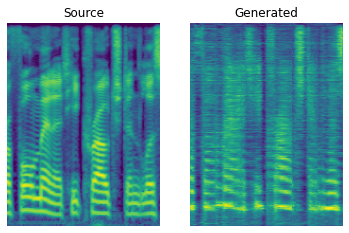

Mean D loss: 0.11376835405826569 Mean G loss: 1.9211050271987915 Mean ID loss: 0.20556044578552246
[Epoch 1/20] [Batch 0] [D loss f: 0.15913230180740356 r: 0.11397846043109894] [G loss: 1.6212965250015259] [ID loss: 0.17297284305095673] [LR: 0.0002]
[Epoch 1/20] [Batch 600] [D loss f: 0.1771957129240036 r: 0.1390172839164734] [G loss: 1.3518881797790527] [ID loss: 0.1795235127210617] [LR: 0.0002]
[Epoch 1/20] [Batch 1200] [D loss f: 0.23076044023036957 r: 0.1672956645488739] [G loss: 1.1230601072311401] [ID loss: 0.1892298310995102] [LR: 0.0002]
Time/Batch 0.023030249045713106
Saving...


  4%|▎         | 70/2000 [00:00<00:04, 457.01it/s, loss=0.000562, spectral_convergence=-10.2]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 519.87it/s, loss=0.000261, spectral_convergence=-32.7]


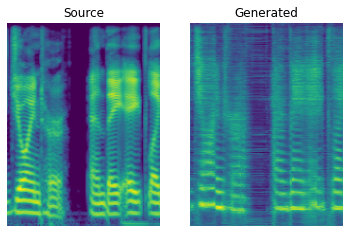

Mean D loss: 0.21340081095695496 Mean G loss: 1.2340188026428223 Mean ID loss: 0.18542741239070892
[Epoch 2/20] [Batch 0] [D loss f: 0.2808683514595032 r: 0.16715465486049652] [G loss: 1.2029531002044678] [ID loss: 0.19292570650577545] [LR: 0.0002]
[Epoch 2/20] [Batch 600] [D loss f: 0.2704639136791229 r: 0.16445936262607574] [G loss: 1.0966224670410156] [ID loss: 0.20058079063892365] [LR: 0.0002]
[Epoch 2/20] [Batch 1200] [D loss f: 0.2896324098110199 r: 0.1630788892507553] [G loss: 0.9952035546302795] [ID loss: 0.21112887561321259] [LR: 0.0002]
Time/Batch 0.02264163946583323
Saving...


  4%|▍         | 80/2000 [00:00<00:03, 534.22it/s, loss=0.00035, spectral_convergence=-7.95] 

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 500.15it/s, loss=0.00054, spectral_convergence=-22]


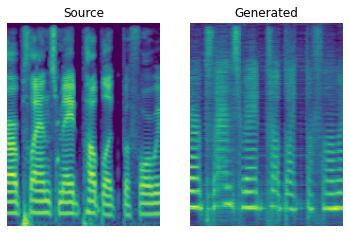

Mean D loss: 0.27858561277389526 Mean G loss: 1.0247479677200317 Mean ID loss: 0.20675501227378845
[Epoch 3/20] [Batch 0] [D loss f: 0.2698621451854706 r: 0.17111431062221527] [G loss: 0.8743655681610107] [ID loss: 0.21310821175575256] [LR: 0.0002]
[Epoch 3/20] [Batch 600] [D loss f: 0.3010779023170471 r: 0.17077523469924927] [G loss: 0.902223527431488] [ID loss: 0.2150050401687622] [LR: 0.0002]
[Epoch 3/20] [Batch 1200] [D loss f: 0.3044207692146301 r: 0.1561787873506546] [G loss: 0.9265275001525879] [ID loss: 0.217681422829628] [LR: 0.0002]
Time/Batch 0.022497156936756885
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 515.21it/s, loss=0.000362, spectral_convergence=-25.7]


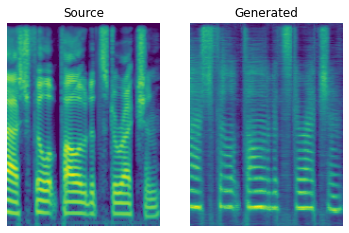

Mean D loss: 0.30260521173477173 Mean G loss: 0.9115859866142273 Mean ID loss: 0.2165316343307495
[Epoch 4/20] [Batch 0] [D loss f: 0.2988564670085907 r: 0.15661831200122833] [G loss: 0.8954917788505554] [ID loss: 0.2178765833377838] [LR: 0.0002]
[Epoch 4/20] [Batch 600] [D loss f: 0.2850196063518524 r: 0.15053844451904297] [G loss: 0.9167404174804688] [ID loss: 0.21700096130371094] [LR: 0.0002]
[Epoch 4/20] [Batch 1200] [D loss f: 0.2821827828884125 r: 0.15175321698188782] [G loss: 0.9156962037086487] [ID loss: 0.21651491522789001] [LR: 0.0002]
Time/Batch 0.0226843976626431
Saving...


  4%|▍         | 80/2000 [00:00<00:03, 547.61it/s, loss=0.000197, spectral_convergence=-9.82]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 526.78it/s, loss=0.000181, spectral_convergence=-35.6]


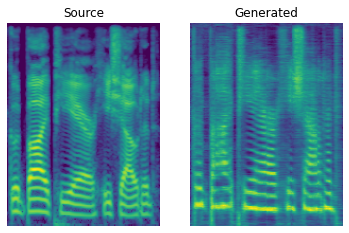

Mean D loss: 0.2834237515926361 Mean G loss: 0.9224663972854614 Mean ID loss: 0.21658559143543243
[Epoch 5/20] [Batch 0] [D loss f: 0.28527605533599854 r: 0.13400790095329285] [G loss: 0.9624701738357544] [ID loss: 0.21542179584503174] [LR: 0.0002]
[Epoch 5/20] [Batch 600] [D loss f: 0.27180159091949463 r: 0.15415166318416595] [G loss: 0.8687272071838379] [ID loss: 0.21214362978935242] [LR: 0.0002]
[Epoch 5/20] [Batch 1200] [D loss f: 0.26668110489845276 r: 0.15033353865146637] [G loss: 0.9203488230705261] [ID loss: 0.20648470520973206] [LR: 0.0002]
Time/Batch 0.022536386712624208
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 531.66it/s, loss=0.00124, spectral_convergence=-19.1]


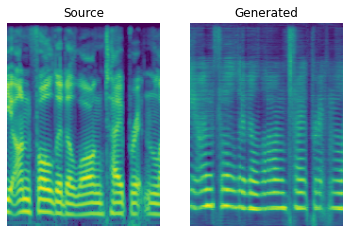

Mean D loss: 0.2685156762599945 Mean G loss: 0.8851381540298462 Mean ID loss: 0.20825374126434326
[Epoch 6/20] [Batch 0] [D loss f: 0.261630117893219 r: 0.17019477486610413] [G loss: 0.8209675550460815] [ID loss: 0.20073528587818146] [LR: 0.0002]
[Epoch 6/20] [Batch 600] [D loss f: 0.26835641264915466 r: 0.15668925642967224] [G loss: 0.9434588551521301] [ID loss: 0.196354478597641] [LR: 0.0002]
[Epoch 6/20] [Batch 1200] [D loss f: 0.25621870160102844 r: 0.1634238064289093] [G loss: 0.9457447528839111] [ID loss: 0.18662771582603455] [LR: 0.0002]
Time/Batch 0.023044584441359026
Saving...


  4%|▍         | 80/2000 [00:00<00:03, 538.21it/s, loss=0.000422, spectral_convergence=-9.87]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 510.01it/s, loss=0.000144, spectral_convergence=-38.9]


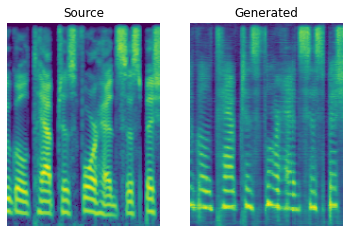

Mean D loss: 0.2626201808452606 Mean G loss: 0.9555561542510986 Mean ID loss: 0.1902085393667221
[Epoch 7/20] [Batch 0] [D loss f: 0.2655779719352722 r: 0.17195464670658112] [G loss: 1.0318050384521484] [ID loss: 0.1810823380947113] [LR: 0.0002]
[Epoch 7/20] [Batch 600] [D loss f: 0.2609999477863312 r: 0.1919952630996704] [G loss: 0.9592093825340271] [ID loss: 0.1713520586490631] [LR: 0.0002]
[Epoch 7/20] [Batch 1200] [D loss f: 0.27071407437324524 r: 0.21983373165130615] [G loss: 0.9114967584609985] [ID loss: 0.15766166150569916] [LR: 0.0002]
Time/Batch 0.023079392683767054
Saving...


  4%|▎         | 70/2000 [00:00<00:04, 470.84it/s, loss=0.00246, spectral_convergence=-9.33]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 515.48it/s, loss=0.000303, spectral_convergence=-28.7]


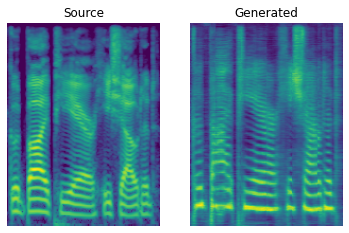

Mean D loss: 0.27077025175094604 Mean G loss: 0.9561797976493835 Mean ID loss: 0.16288602352142334
[Epoch 8/20] [Batch 0] [D loss f: 0.30638110637664795 r: 0.23453262448310852] [G loss: 1.1012237071990967] [ID loss: 0.15132950246334076] [LR: 0.0002]
[Epoch 8/20] [Batch 600] [D loss f: 0.302605539560318 r: 0.244886577129364] [G loss: 1.001237392425537] [ID loss: 0.1459328979253769] [LR: 0.0002]
[Epoch 8/20] [Batch 1200] [D loss f: 0.32167306542396545 r: 0.28038665652275085] [G loss: 0.9974890351295471] [ID loss: 0.13683614134788513] [LR: 0.0002]
Time/Batch 0.022960586095378346
Saving...


  4%|▍         | 80/2000 [00:00<00:03, 523.42it/s, loss=0.0152, spectral_convergence=-6.9] 

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 521.63it/s, loss=0.000746, spectral_convergence=-26.3]


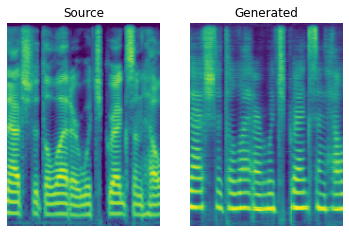

Mean D loss: 0.3130575120449066 Mean G loss: 0.9954049587249756 Mean ID loss: 0.1404619812965393
[Epoch 9/20] [Batch 0] [D loss f: 0.31646689772605896 r: 0.31447526812553406] [G loss: 0.9735385775566101] [ID loss: 0.1338871270418167] [LR: 0.0002]
[Epoch 9/20] [Batch 600] [D loss f: 0.3379574716091156 r: 0.32637226581573486] [G loss: 0.939675509929657] [ID loss: 0.1311880201101303] [LR: 0.0002]
[Epoch 9/20] [Batch 1200] [D loss f: 0.355487585067749 r: 0.35399872064590454] [G loss: 0.9695355296134949] [ID loss: 0.12956412136554718] [LR: 0.0002]
Time/Batch 0.023129648535791105
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 520.95it/s, loss=0.000256, spectral_convergence=-35.3]


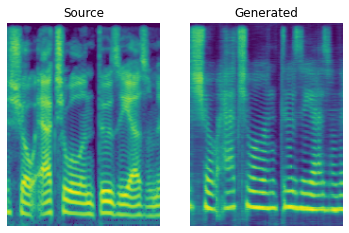

Mean D loss: 0.3490893840789795 Mean G loss: 0.9559904932975769 Mean ID loss: 0.1303037703037262
[Epoch 10/20] [Batch 0] [D loss f: 0.36749741435050964 r: 0.3741535246372223] [G loss: 0.9614471793174744] [ID loss: 0.12986136972904205] [LR: 0.0002]
[Epoch 10/20] [Batch 600] [D loss f: 0.37305957078933716 r: 0.37599027156829834] [G loss: 0.9620553851127625] [ID loss: 0.13121217489242554] [LR: 0.0002]
[Epoch 10/20] [Batch 1200] [D loss f: 0.37932178378105164 r: 0.4018387198448181] [G loss: 1.012943148612976] [ID loss: 0.13192611932754517] [LR: 0.0002]
Time/Batch 0.022421708420245316
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 511.31it/s, loss=0.000528, spectral_convergence=-24.5]


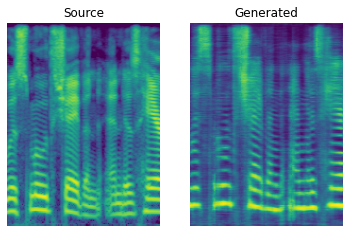

Mean D loss: 0.37582576274871826 Mean G loss: 0.9910058975219727 Mean ID loss: 0.13163453340530396
[Epoch 11/20] [Batch 0] [D loss f: 0.37146416306495667 r: 0.42739930748939514] [G loss: 1.0210545063018799] [ID loss: 0.1320676952600479] [LR: 0.0002]
[Epoch 11/20] [Batch 600] [D loss f: 0.3822691738605499 r: 0.41738173365592957] [G loss: 0.9906982183456421] [ID loss: 0.13401031494140625] [LR: 0.0002]
[Epoch 11/20] [Batch 1200] [D loss f: 0.36649876832962036 r: 0.43064025044441223] [G loss: 0.9253289699554443] [ID loss: 0.13443399965763092] [LR: 0.0002]
Time/Batch 0.022760947777407014
Saving...


  4%|▍         | 80/2000 [00:00<00:03, 532.72it/s, loss=0.16, spectral_convergence=-2.29] 

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 525.52it/s, loss=0.000305, spectral_convergence=-27.2]


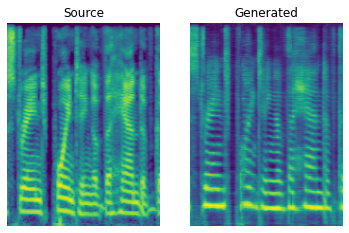

Mean D loss: 0.3766074478626251 Mean G loss: 0.9618460536003113 Mean ID loss: 0.13405925035476685
[Epoch 12/20] [Batch 0] [D loss f: 0.39374876022338867 r: 0.41626185178756714] [G loss: 0.9838758111000061] [ID loss: 0.13289591670036316] [LR: 0.0002]
[Epoch 12/20] [Batch 600] [D loss f: 0.38696563243865967 r: 0.42439818382263184] [G loss: 0.9808632135391235] [ID loss: 0.13373039662837982] [LR: 0.0002]
[Epoch 12/20] [Batch 1200] [D loss f: 0.37930986285209656 r: 0.4303809702396393] [G loss: 0.982468843460083] [ID loss: 0.13375291228294373] [LR: 0.0002]
Time/Batch 0.022533292839997006
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 505.81it/s, loss=0.000419, spectral_convergence=-21]


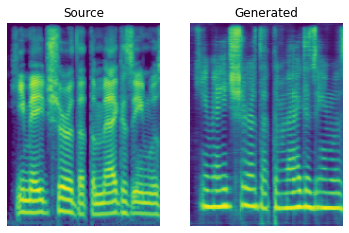

Mean D loss: 0.3830663859844208 Mean G loss: 0.9897641539573669 Mean ID loss: 0.13357993960380554
[Epoch 13/20] [Batch 0] [D loss f: 0.38085874915122986 r: 0.4250222444534302] [G loss: 1.0535305738449097] [ID loss: 0.13247793912887573] [LR: 0.0002]
[Epoch 13/20] [Batch 600] [D loss f: 0.3991389572620392 r: 0.42466461658477783] [G loss: 1.0492982864379883] [ID loss: 0.1329597532749176] [LR: 0.0002]
[Epoch 13/20] [Batch 1200] [D loss f: 0.38002216815948486 r: 0.4352717995643616] [G loss: 0.9310740232467651] [ID loss: 0.13276153802871704] [LR: 0.0002]
Time/Batch 0.0224994017259918
Saving...


  4%|▍         | 90/2000 [00:00<00:03, 549.74it/s, loss=0.232, spectral_convergence=-2.08]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 503.59it/s, loss=0.000198, spectral_convergence=-32.2]


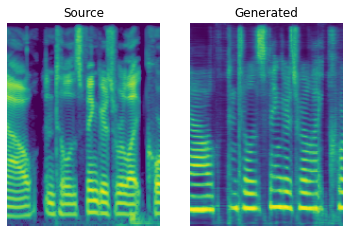

Mean D loss: 0.387905091047287 Mean G loss: 0.9728850722312927 Mean ID loss: 0.13291484117507935
[Epoch 14/20] [Batch 0] [D loss f: 0.3761471211910248 r: 0.4357031583786011] [G loss: 0.8495659828186035] [ID loss: 0.1332802176475525] [LR: 0.0002]
[Epoch 14/20] [Batch 600] [D loss f: 0.3913222849369049 r: 0.4355766773223877] [G loss: 0.986009955406189] [ID loss: 0.13253052532672882] [LR: 0.0002]
[Epoch 14/20] [Batch 1200] [D loss f: 0.3813180923461914 r: 0.44314178824424744] [G loss: 0.9254990816116333] [ID loss: 0.13209232687950134] [LR: 0.0002]
Time/Batch 0.022824396008122576
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 504.84it/s, loss=0.000305, spectral_convergence=-33.2]


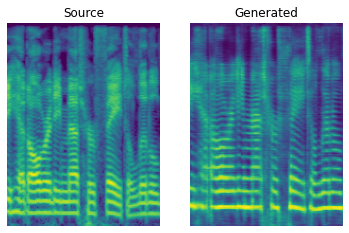

Mean D loss: 0.38212287425994873 Mean G loss: 0.9435890913009644 Mean ID loss: 0.13231465220451355
[Epoch 15/20] [Batch 0] [D loss f: 0.3562800884246826 r: 0.4492461383342743] [G loss: 0.850532591342926] [ID loss: 0.13235995173454285] [LR: 0.0002]
[Epoch 15/20] [Batch 600] [D loss f: 0.36848002672195435 r: 0.4455811679363251] [G loss: 0.8990519046783447] [ID loss: 0.13195163011550903] [LR: 0.0002]
[Epoch 15/20] [Batch 1200] [D loss f: 0.37981361150741577 r: 0.4455649256706238] [G loss: 0.9072771072387695] [ID loss: 0.13177329301834106] [LR: 0.0002]
Time/Batch 0.02255653012407957
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 524.25it/s, loss=0.00012, spectral_convergence=-28.7]


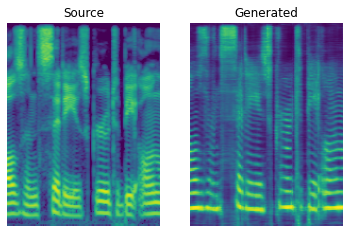

Mean D loss: 0.37478363513946533 Mean G loss: 0.8857612609863281 Mean ID loss: 0.1318005472421646
[Epoch 16/20] [Batch 0] [D loss f: 0.37937256693840027 r: 0.45678460597991943] [G loss: 0.7636231780052185] [ID loss: 0.131331667304039] [LR: 0.0002]
[Epoch 16/20] [Batch 600] [D loss f: 0.3850017786026001 r: 0.440613716840744] [G loss: 0.9412519335746765] [ID loss: 0.13034848868846893] [LR: 0.0002]
[Epoch 16/20] [Batch 1200] [D loss f: 0.387123703956604 r: 0.42870625853538513] [G loss: 0.9547277092933655] [ID loss: 0.128406822681427] [LR: 0.0002]
Time/Batch 0.02292122649450372
Saving...


  4%|▍         | 80/2000 [00:00<00:03, 526.22it/s, loss=0.0926, spectral_convergence=-3.1]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:04<00:00, 499.98it/s, loss=0.000484, spectral_convergence=-29.3]


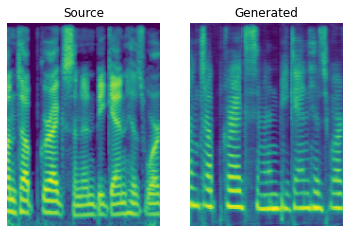

Mean D loss: 0.38653069734573364 Mean G loss: 0.9377692341804504 Mean ID loss: 0.12906798720359802
[Epoch 17/20] [Batch 0] [D loss f: 0.3879360556602478 r: 0.4348711669445038] [G loss: 0.8682692646980286] [ID loss: 0.1268707662820816] [LR: 0.0002]
[Epoch 17/20] [Batch 600] [D loss f: 0.3847343325614929 r: 0.4306270480155945] [G loss: 0.8666107058525085] [ID loss: 0.12641730904579163] [LR: 0.0002]
[Epoch 17/20] [Batch 1200] [D loss f: 0.3799593150615692 r: 0.43160104751586914] [G loss: 0.8412026166915894] [ID loss: 0.12535548210144043] [LR: 0.0002]
Time/Batch 0.022977828283379548
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 534.43it/s, loss=0.000255, spectral_convergence=-30.3]


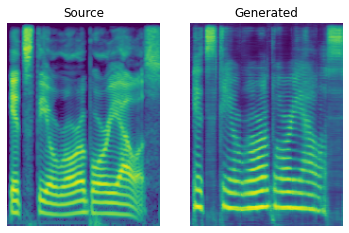

Mean D loss: 0.37897440791130066 Mean G loss: 0.8531302809715271 Mean ID loss: 0.12570001184940338
[Epoch 18/20] [Batch 0] [D loss f: 0.3577742278575897 r: 0.4132372736930847] [G loss: 0.8447619080543518] [ID loss: 0.12435901910066605] [LR: 0.0002]
[Epoch 18/20] [Batch 600] [D loss f: 0.3895544111728668 r: 0.4194086492061615] [G loss: 0.9102878570556641] [ID loss: 0.12452323734760284] [LR: 0.0002]
[Epoch 18/20] [Batch 1200] [D loss f: 0.3827441930770874 r: 0.41945239901542664] [G loss: 0.855704665184021] [ID loss: 0.12340114265680313] [LR: 0.0002]
Time/Batch 0.022304949447186324
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 543.60it/s, loss=0.000471, spectral_convergence=-29.8]


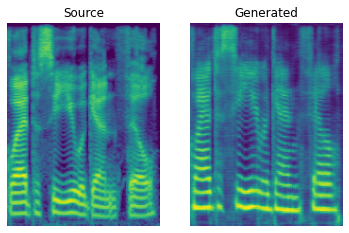

Mean D loss: 0.38492757081985474 Mean G loss: 0.8775151371955872 Mean ID loss: 0.12381462007761002
[Epoch 19/20] [Batch 0] [D loss f: 0.3727017045021057 r: 0.42024436593055725] [G loss: 0.8442460298538208] [ID loss: 0.12278608977794647] [LR: 0.0002]
[Epoch 19/20] [Batch 600] [D loss f: 0.37838131189346313 r: 0.4241541922092438] [G loss: 0.7608494162559509] [ID loss: 0.12354638427495956] [LR: 0.0002]
[Epoch 19/20] [Batch 1200] [D loss f: 0.37934035062789917 r: 0.42060190439224243] [G loss: 0.8014534115791321] [ID loss: 0.12325581908226013] [LR: 0.0002]
Time/Batch 0.022372185922887203
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 536.45it/s, loss=0.000481, spectral_convergence=-23.7]


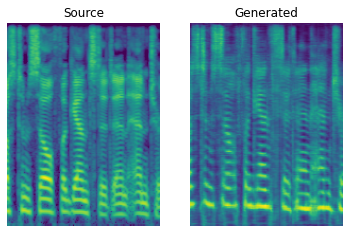

Mean D loss: 0.3788670599460602 Mean G loss: 0.7794511914253235 Mean ID loss: 0.12329649925231934


In [275]:
#Training

#n_save = how many epochs between each saving and displaying of results
#gupt = how many discriminator updates for generator+siamese update

train(epochs=ep, batch_size=bs, lr=0.0002, n_save=1, gupt=3, save_path=MODELS_DIR)

# Inference

## Utils

In [282]:
#After Training, use these functions to convert data with the generator and save the results

#Assembling generated Spectrogram chunks into final Spectrogram
def specass(a,spec):
  but=False
  con = np.array([])
  nim = a.shape[0]
  for i in range(nim-1):
    im = a[i]
    im = np.squeeze(im)
    if not but:
      con=im
      but=True
    else:
      con = np.concatenate((con,im), axis=1)
  diff = spec.shape[1]-(nim*shape)
  a = np.squeeze(a)
  con = np.concatenate((con,a[-1,:,-diff:]), axis=1)
  return np.squeeze(con)

#Splitting input spectrogram into different chunks to feed to the generator
def chopspec(spec):
  dsa=[]
  for i in range(spec.shape[1]//shape):
    im = spec[:,i*shape:i*shape+shape]
    im = np.reshape(im, (im.shape[0],im.shape[1],1))
    dsa.append(im)
  imlast = spec[:,-shape:]
  imlast = np.reshape(imlast, (imlast.shape[0],imlast.shape[1],1))
  dsa.append(imlast)
  return np.array(dsa, dtype=np.float32)

#Converting from source Spectrogram to target Spectrogram
def towave(spec, name, path, show=False):
  specarr = chopspec(spec)
  print(specarr.shape)
  a = specarr
  print('Generating...')
  ab = gen(a, training=False)
  print('Assembling and Converting...')
  a = specass(a,spec)
  ab = specass(ab,spec)
  awv = deprep(a)
  abwv = deprep(ab)
  print('Saving...')
  pathfin = f'{path}/{name}'
  # os.mkdir(pathfin)
  sf.write(pathfin+'_target.wav', abwv, sr)
  sf.write(pathfin+'_source.wav', awv, sr)
  print('Saved WAV!')
  IPython.display.display(IPython.display.Audio(np.squeeze(abwv), rate=sr))
  IPython.display.display(IPython.display.Audio(np.squeeze(awv), rate=sr))
  if show:
    fig, axs = plt.subplots(ncols=2)
    axs[0].imshow(np.flip(a, -2), cmap=None)
    axs[0].axis('off')
    axs[0].set_title('Source')
    axs[1].imshow(np.flip(ab, -2), cmap=None)
    axs[1].axis('off')
    axs[1].set_title('Generated')
    plt.show()
  return abwv

## Convert and save audios

['/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0161.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0262.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0253.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0239.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0201.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0183.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0162.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0211.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0189.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0165.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0218.wav', '/content/drive/MyDrive/nlp-project/male_240_generation_src/arctic_a0180.wav', '/content/drive/MyDrive/nlp-project/male_240_genera

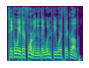

  0%|          | 0/2000 [00:00<?, ?it/s]

(12, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 512.67it/s, loss=0.0271, spectral_convergence=-16]


Saving...
Saved WAV!


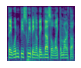

  1%|          | 20/2000 [00:00<00:05, 367.05it/s, loss=0.0185, spectral_convergence=-.212] 

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 506.87it/s, loss=0.0246, spectral_convergence=-14]


Saving...
Saved WAV!


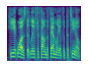

  0%|          | 10/2000 [00:00<00:08, 238.43it/s, loss=0.0139, spectral_convergence=-.0697]

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 519.02it/s, loss=0.0147, spectral_convergence=-12.8]


Saving...
Saved WAV!


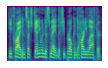

  0%|          | 10/2000 [00:00<00:07, 262.55it/s, loss=0.018, spectral_convergence=-.0926]

(14, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 517.92it/s, loss=0.028, spectral_convergence=-13.6]


Saving...
Saved WAV!


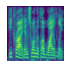

  0%|          | 10/2000 [00:00<00:08, 221.18it/s, loss=0.0204, spectral_convergence=-.0981]

(9, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 482.68it/s, loss=0.0174, spectral_convergence=-11.8]


Saving...
Saved WAV!


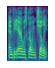

  1%|          | 20/2000 [00:00<00:05, 331.26it/s, loss=0.029, spectral_convergence=-.225]  

(7, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 481.21it/s, loss=0.0227, spectral_convergence=-16]


Saving...
Saved WAV!


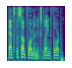

  2%|▏         | 40/2000 [00:00<00:04, 408.14it/s, loss=0.0122, spectral_convergence=-1.35]

(9, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 510.79it/s, loss=0.0207, spectral_convergence=-12.6]


Saving...
Saved WAV!


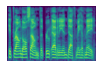

  2%|▏         | 30/2000 [00:00<00:05, 348.34it/s, loss=0.0134, spectral_convergence=-1.07]

(14, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 496.11it/s, loss=0.0284, spectral_convergence=-12]


Saving...
Saved WAV!


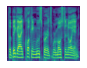

  1%|          | 20/2000 [00:00<00:05, 361.12it/s, loss=0.023, spectral_convergence=-.271]  

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 519.50it/s, loss=0.0333, spectral_convergence=-12.6]


Saving...
Saved WAV!


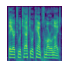

  2%|▏         | 40/2000 [00:00<00:04, 442.32it/s, loss=0.00942, spectral_convergence=-1.8]

(9, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 525.96it/s, loss=0.0249, spectral_convergence=-14.4]

Saving...
Saved WAV!


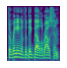

  2%|▏         | 30/2000 [00:00<00:04, 397.86it/s, loss=0.0359, spectral_convergence=-.413]

(8, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 503.59it/s, loss=0.0504, spectral_convergence=-14.3]


Saving...
Saved WAV!


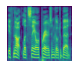

  2%|▏         | 40/2000 [00:00<00:04, 422.18it/s, loss=0.0275, spectral_convergence=-1.1] 

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 528.29it/s, loss=0.0196, spectral_convergence=-13.5]


Saving...
Saved WAV!


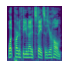

  2%|▏         | 30/2000 [00:00<00:05, 373.29it/s, loss=0.00859, spectral_convergence=-.792]

(9, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 522.26it/s, loss=0.0198, spectral_convergence=-12.9]


Saving...
Saved WAV!


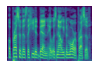

  2%|▎         | 50/2000 [00:00<00:04, 474.40it/s, loss=0.0142, spectral_convergence=-1.32]

(13, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 508.32it/s, loss=0.0227, spectral_convergence=-14.8]


Saving...
Saved WAV!


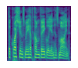

  2%|▏         | 30/2000 [00:00<00:05, 378.02it/s, loss=0.013, spectral_convergence=-.614] 

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 495.86it/s, loss=0.0279, spectral_convergence=-12.9]


Saving...
Saved WAV!


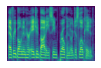

  2%|▏         | 30/2000 [00:00<00:04, 402.83it/s, loss=0.0149, spectral_convergence=-.547]

(13, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 521.14it/s, loss=0.0253, spectral_convergence=-15.9]


Saving...
Saved WAV!


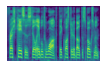

  2%|▏         | 30/2000 [00:00<00:05, 377.98it/s, loss=0.0163, spectral_convergence=-.577]

(14, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 509.51it/s, loss=0.0113, spectral_convergence=-17.1]


Saving...
Saved WAV!


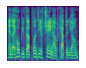

  2%|▏         | 30/2000 [00:00<00:05, 391.50it/s, loss=0.00909, spectral_convergence=-.727]

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 504.83it/s, loss=0.0199, spectral_convergence=-13.3]


Saving...
Saved WAV!


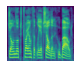

  2%|▏         | 30/2000 [00:00<00:05, 378.49it/s, loss=0.0131, spectral_convergence=-.938]

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 518.79it/s, loss=0.0259, spectral_convergence=-12.6]


Saving...
Saved WAV!


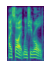

  2%|▏         | 40/2000 [00:00<00:04, 413.69it/s, loss=0.0153, spectral_convergence=-1.36]

(6, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 504.00it/s, loss=0.026, spectral_convergence=-14.5]


Saving...
Saved WAV!


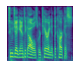

  2%|▎         | 50/2000 [00:00<00:04, 454.27it/s, loss=0.0148, spectral_convergence=-1.33]

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 503.70it/s, loss=0.0262, spectral_convergence=-14]


Saving...
Saved WAV!


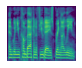

  2%|▏         | 30/2000 [00:00<00:05, 373.20it/s, loss=0.0135, spectral_convergence=-.677]

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 499.00it/s, loss=0.0335, spectral_convergence=-14.5]


Saving...
Saved WAV!


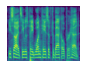

  2%|▏         | 30/2000 [00:00<00:05, 363.55it/s, loss=0.0132, spectral_convergence=-.802]

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 514.04it/s, loss=0.025, spectral_convergence=-14.4]


Saving...
Saved WAV!


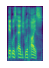

  2%|▏         | 30/2000 [00:00<00:05, 389.20it/s, loss=0.0151, spectral_convergence=-.531]

(6, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 495.44it/s, loss=0.0108, spectral_convergence=-15]


Saving...
Saved WAV!


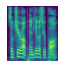

  2%|▏         | 40/2000 [00:00<00:04, 428.05it/s, loss=0.0191, spectral_convergence=-1.42]

(8, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 524.32it/s, loss=0.0159, spectral_convergence=-14.2]


Saving...
Saved WAV!


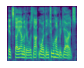

  2%|▏         | 30/2000 [00:00<00:05, 342.67it/s, loss=0.0162, spectral_convergence=-1.25]

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 515.12it/s, loss=0.0279, spectral_convergence=-12.4]


Saving...
Saved WAV!


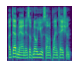

  2%|▏         | 30/2000 [00:00<00:05, 342.82it/s, loss=0.0163, spectral_convergence=-.469]

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 507.07it/s, loss=0.0332, spectral_convergence=-11.9]


Saving...
Saved WAV!


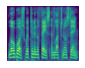

  2%|▏         | 30/2000 [00:00<00:05, 371.03it/s, loss=0.0237, spectral_convergence=-.401]

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 499.05it/s, loss=0.0168, spectral_convergence=-14.4]


Saving...
Saved WAV!


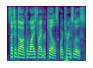

  1%|          | 20/2000 [00:00<00:06, 288.94it/s, loss=0.0181, spectral_convergence=-.295] 

(12, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 494.87it/s, loss=0.0269, spectral_convergence=-12.6]


Saving...
Saved WAV!


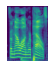

  2%|▏         | 30/2000 [00:00<00:05, 360.47it/s, loss=0.0194, spectral_convergence=-.834]

(7, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 506.91it/s, loss=0.0335, spectral_convergence=-12.9]


Saving...
Saved WAV!


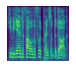

  2%|▏         | 30/2000 [00:00<00:05, 391.98it/s, loss=0.0134, spectral_convergence=-.698]

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 504.89it/s, loss=0.0253, spectral_convergence=-15.5]


Saving...
Saved WAV!


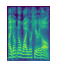

  2%|▏         | 40/2000 [00:00<00:04, 428.04it/s, loss=0.0161, spectral_convergence=-2.06]

(7, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 512.42it/s, loss=0.0321, spectral_convergence=-13.7]


Saving...
Saved WAV!


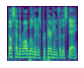

  2%|▏         | 40/2000 [00:00<00:04, 428.89it/s, loss=0.0185, spectral_convergence=-.939]

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 502.79it/s, loss=0.0213, spectral_convergence=-14.2]


Saving...
Saved WAV!


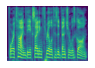

  2%|▏         | 30/2000 [00:00<00:04, 397.26it/s, loss=0.0162, spectral_convergence=-.907]

(12, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 502.69it/s, loss=0.0279, spectral_convergence=-13.2]


Saving...
Saved WAV!


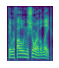

  2%|▏         | 30/2000 [00:00<00:05, 371.57it/s, loss=0.0117, spectral_convergence=-1.07]

(7, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 507.32it/s, loss=0.0394, spectral_convergence=-10.9]


Saving...
Saved WAV!


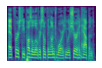

  2%|▏         | 30/2000 [00:00<00:04, 396.44it/s, loss=0.0101, spectral_convergence=-1.17]

(14, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 495.10it/s, loss=0.0212, spectral_convergence=-15.2]


Saving...
Saved WAV!


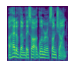

  2%|▏         | 30/2000 [00:00<00:04, 396.25it/s, loss=0.0177, spectral_convergence=-.353]

(9, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 502.07it/s, loss=0.0188, spectral_convergence=-12.9]


Saving...
Saved WAV!


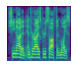

  2%|▏         | 40/2000 [00:00<00:04, 422.30it/s, loss=0.0146, spectral_convergence=-1.58]

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 487.66it/s, loss=0.0396, spectral_convergence=-10.4]


Saving...
Saved WAV!


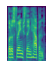

  2%|▏         | 30/2000 [00:00<00:06, 325.89it/s, loss=0.0139, spectral_convergence=-1.04]

(6, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 509.94it/s, loss=0.0245, spectral_convergence=-13.2]


Saving...
Saved WAV!


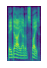

  2%|▎         | 50/2000 [00:00<00:04, 467.89it/s, loss=0.0129, spectral_convergence=-1.22]

(5, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 515.43it/s, loss=0.0151, spectral_convergence=-14]


Saving...
Saved WAV!


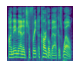

  2%|▏         | 40/2000 [00:00<00:04, 418.99it/s, loss=0.014, spectral_convergence=-2.04] 

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 506.80it/s, loss=0.0307, spectral_convergence=-11.3]


Saving...
Saved WAV!


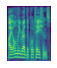

  2%|▏         | 30/2000 [00:00<00:05, 359.70it/s, loss=0.0103, spectral_convergence=-1.17]

(7, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 507.99it/s, loss=0.0311, spectral_convergence=-16.7]


Saving...
Saved WAV!


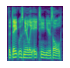

  2%|▎         | 50/2000 [00:00<00:03, 498.73it/s, loss=0.0071, spectral_convergence=-2.45]

(9, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 516.42it/s, loss=0.0333, spectral_convergence=-14.1]


Saving...
Saved WAV!


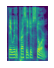

  2%|▎         | 50/2000 [00:00<00:03, 493.91it/s, loss=0.0227, spectral_convergence=-1.11]

(6, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 478.94it/s, loss=0.0209, spectral_convergence=-14.3]


Saving...
Saved WAV!


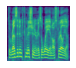

  2%|▏         | 30/2000 [00:00<00:05, 347.20it/s, loss=0.0214, spectral_convergence=-.688]

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 472.43it/s, loss=0.0241, spectral_convergence=-14.8]


Saving...
Saved WAV!


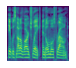

  1%|          | 20/2000 [00:00<00:05, 350.26it/s, loss=0.0245, spectral_convergence=-.242]

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 508.07it/s, loss=0.036, spectral_convergence=-13.2]


Saving...
Saved WAV!


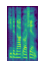

  2%|▏         | 30/2000 [00:00<00:05, 368.26it/s, loss=0.0238, spectral_convergence=-.537]

(5, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 511.18it/s, loss=0.0306, spectral_convergence=-11.2]


Saving...
Saved WAV!


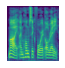

  2%|▎         | 50/2000 [00:00<00:04, 475.78it/s, loss=0.0196, spectral_convergence=-1.61]

(8, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 490.86it/s, loss=0.0182, spectral_convergence=-14.7]


Saving...
Saved WAV!


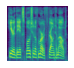

  2%|▏         | 30/2000 [00:00<00:06, 326.79it/s, loss=0.0207, spectral_convergence=-.841]

(9, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 506.06it/s, loss=0.0215, spectral_convergence=-13.2]


Saving...
Saved WAV!


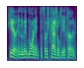

  2%|▏         | 30/2000 [00:00<00:05, 387.93it/s, loss=0.0114, spectral_convergence=-.765]

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 501.05it/s, loss=0.022, spectral_convergence=-13.5]


Saving...
Saved WAV!


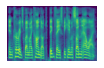

  2%|▏         | 30/2000 [00:00<00:05, 353.47it/s, loss=0.0145, spectral_convergence=-.865]

(14, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 492.70it/s, loss=0.0277, spectral_convergence=-12.2]


Saving...
Saved WAV!


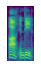

  2%|▏         | 30/2000 [00:00<00:05, 347.83it/s, loss=0.0122, spectral_convergence=-.747]

(4, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 494.50it/s, loss=0.0139, spectral_convergence=-13.4]


Saving...
Saved WAV!


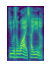

  2%|▏         | 30/2000 [00:00<00:05, 365.02it/s, loss=0.0173, spectral_convergence=-.763]

(6, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 509.23it/s, loss=0.0232, spectral_convergence=-13.3]


Saving...
Saved WAV!


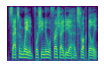

  2%|▏         | 30/2000 [00:00<00:05, 375.68it/s, loss=0.0114, spectral_convergence=-1.08]

(14, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 490.85it/s, loss=0.0294, spectral_convergence=-14.8]


Saving...
Saved WAV!


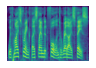

  2%|▏         | 30/2000 [00:00<00:04, 399.77it/s, loss=0.0214, spectral_convergence=-.692]

(13, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 500.68it/s, loss=0.0149, spectral_convergence=-13.5]


Saving...
Saved WAV!


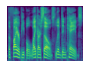

  1%|          | 20/2000 [00:00<00:06, 308.72it/s, loss=0.0111, spectral_convergence=-.263] 

(12, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 510.80it/s, loss=0.0147, spectral_convergence=-12.6]


Saving...
Saved WAV!


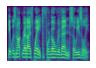

  2%|▏         | 30/2000 [00:00<00:05, 371.66it/s, loss=0.0198, spectral_convergence=-.55] 

(13, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 501.63it/s, loss=0.0262, spectral_convergence=-15.6]


Saving...
Saved WAV!


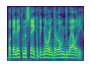

  2%|▏         | 30/2000 [00:00<00:05, 366.73it/s, loss=0.0245, spectral_convergence=-.954]

(12, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 501.95it/s, loss=0.0451, spectral_convergence=-14.1]


Saving...
Saved WAV!


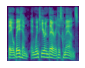

  2%|▏         | 30/2000 [00:00<00:05, 370.87it/s, loss=0.0181, spectral_convergence=-.604]

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 507.31it/s, loss=0.0292, spectral_convergence=-12.8]


Saving...
Saved WAV!


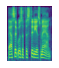

  2%|▏         | 30/2000 [00:00<00:04, 398.43it/s, loss=0.0243, spectral_convergence=-.488]

(7, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 480.99it/s, loss=0.0181, spectral_convergence=-15.5]


Saving...
Saved WAV!


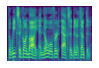

  2%|▏         | 30/2000 [00:00<00:05, 353.02it/s, loss=0.0181, spectral_convergence=-.703]

(13, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 493.56it/s, loss=0.0202, spectral_convergence=-15.1]


Saving...
Saved WAV!


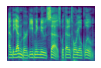

  1%|          | 20/2000 [00:00<00:06, 315.35it/s, loss=0.0179, spectral_convergence=-.404] 

(13, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 508.32it/s, loss=0.0324, spectral_convergence=-16.1]


Saving...
Saved WAV!


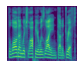

  2%|▏         | 30/2000 [00:00<00:04, 400.59it/s, loss=0.0121, spectral_convergence=-.62] 

(11, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 505.77it/s, loss=0.0223, spectral_convergence=-15.2]


Saving...
Saved WAV!


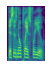

  2%|▏         | 40/2000 [00:00<00:04, 403.34it/s, loss=0.0212, spectral_convergence=-1.22]

(6, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 521.28it/s, loss=0.0201, spectral_convergence=-13.9]


Saving...
Saved WAV!


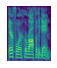

  2%|▏         | 40/2000 [00:00<00:04, 407.51it/s, loss=0.0133, spectral_convergence=-1.1] 

(7, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 522.60it/s, loss=0.0306, spectral_convergence=-15.2]


Saving...
Saved WAV!


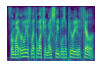

  2%|▏         | 30/2000 [00:00<00:04, 394.85it/s, loss=0.0204, spectral_convergence=-.583]

(13, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 524.78it/s, loss=0.028, spectral_convergence=-15.3]


Saving...
Saved WAV!


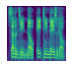

  1%|          | 20/2000 [00:00<00:05, 344.41it/s, loss=0.018, spectral_convergence=-.277]

(9, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 499.67it/s, loss=0.0281, spectral_convergence=-13.2]


Saving...
Saved WAV!


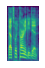

  2%|▏         | 40/2000 [00:00<00:04, 415.99it/s, loss=0.00536, spectral_convergence=-2.84]

(5, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 506.44it/s, loss=0.012, spectral_convergence=-13.6]


Saving...
Saved WAV!


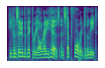

  2%|▏         | 40/2000 [00:00<00:04, 414.68it/s, loss=0.0184, spectral_convergence=-1.15]

(14, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 523.29it/s, loss=0.0219, spectral_convergence=-12.6]


Saving...
Saved WAV!


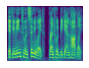

  2%|▏         | 30/2000 [00:00<00:04, 420.05it/s, loss=0.0135, spectral_convergence=-1.43]

(12, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 509.45it/s, loss=0.0166, spectral_convergence=-16.1]


Saving...
Saved WAV!


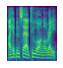

  1%|          | 20/2000 [00:00<00:06, 283.67it/s, loss=0.0113, spectral_convergence=-.673]

(8, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 514.16it/s, loss=0.0231, spectral_convergence=-13.7]


Saving...
Saved WAV!


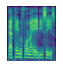

  2%|▎         | 50/2000 [00:00<00:03, 498.65it/s, loss=0.00662, spectral_convergence=-2.57]

(8, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 504.91it/s, loss=0.0241, spectral_convergence=-14.9]


Saving...
Saved WAV!


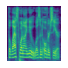

  2%|▏         | 40/2000 [00:00<00:04, 431.95it/s, loss=0.0126, spectral_convergence=-1.64]

(8, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 516.27it/s, loss=0.0271, spectral_convergence=-14.5]


Saving...
Saved WAV!


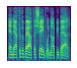

  2%|▏         | 30/2000 [00:00<00:05, 374.50it/s, loss=0.00956, spectral_convergence=-.834]

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 522.39it/s, loss=0.0213, spectral_convergence=-16.4]


Saving...
Saved WAV!


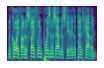

  2%|▏         | 30/2000 [00:00<00:04, 400.50it/s, loss=0.0216, spectral_convergence=-.395]

(14, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 496.38it/s, loss=0.0179, spectral_convergence=-15.6]


Saving...
Saved WAV!


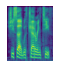

  1%|          | 20/2000 [00:00<00:06, 319.39it/s, loss=0.0197, spectral_convergence=-.203] 

(7, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 497.93it/s, loss=0.0193, spectral_convergence=-14.3]


Saving...
Saved WAV!


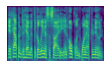

  0%|          | 10/2000 [00:00<00:07, 252.90it/s, loss=0.00868, spectral_convergence=-.196]

(15, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 493.82it/s, loss=0.0209, spectral_convergence=-15.8]


Saving...
Saved WAV!


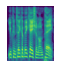

  1%|          | 20/2000 [00:00<00:05, 330.46it/s, loss=0.02, spectral_convergence=-.243]   

(7, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 491.36it/s, loss=0.0191, spectral_convergence=-15.3]


Saving...
Saved WAV!


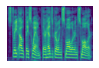

  1%|          | 20/2000 [00:00<00:06, 305.54it/s, loss=0.0185, spectral_convergence=-.233] 

(13, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:03<00:00, 505.60it/s, loss=0.0286, spectral_convergence=-14.4]


Saving...
Saved WAV!


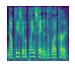

  2%|▏         | 30/2000 [00:00<00:05, 393.93it/s, loss=0.0328, spectral_convergence=-.431]

(10, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:04<00:00, 495.39it/s, loss=0.0134, spectral_convergence=-11.8]


Saving...
Saved WAV!


In [286]:
from datetime import datetime

waveforms, src_wav_paths =audio_array(GENERATION_SRC_DIR, limit=80)

total = len(waveforms)

for i, wv in enumerate(waveforms):
  print('==========')
  print(f'Converting and saving {i+1}/{total} audio file...')

  speca = prep(wv)                                                    #Waveform to Spectrogram
  
  plt.figure(figsize=(50,1))                                          #Show Spectrogram
  plt.imshow(np.flip(speca, axis=0), cmap=None)
  plt.axis('off')
  plt.show()
  
  name = (src_wav_paths[i].split('/')[-1]).replace('.wav', '')
  abwv = towave(speca, name=name, path=GENERATION_TGT_DIR)           #Convert and save wav